In [1]:
# !pip install wand

In [2]:
# Importing libraries
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from matplotlib import rc
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, transforms
from PIL import Image as IMAGE
from IPython import display
from IPython.display import HTML, Image

In [3]:
# Plotting pretty figures and avoid blurry images
%config InlineBackend.figure_format = 'retina'    
# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [4]:
#Define helper function for min-max normalization
def normalize(arr: np.ndarray) -> np.ndarray:
    """
    Min-max normalizes a numpy array
    """
    return (arr - arr.min()) / (arr.max() - arr.min())

# Question 1

**Variants of Backprop for visualizing CNNs**

Download a ResNet-50 trained on the ILSVRC classification task and 5 images from here. Considering the neuron corresponding to the highest predicted score in the output layer, implement and visualize the results for

(a) Vanilla Backpropagation (you may use the builtin implementation)

(b) Guided-back-propagation (you may use the builtin grad function for computing gradient of a node with other in the computational graph)

(c) Class Activation Map (CAM) 

(d) Guided Grad-CAM 

In [5]:
# Load the ResNet-50 model
model = models.resnet50(pretrained=True)
model.eval()

# Load the images
images = []
for i in range(5):
    img = IMAGE.open(f"i{i+1}.jpg")
    images.append(img)

### Vanilla Backpropagation

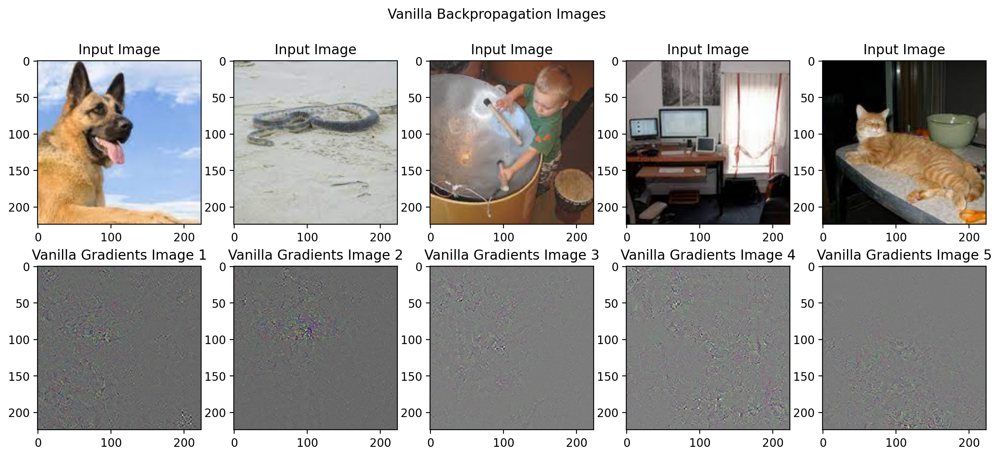

In [6]:
# Define the VanillaBackpropagation class
class VanillaBackprop:
    def __init__(self, model):
        self.model = model

    def __call__(self, input_image):
        input_image.requires_grad_()
        self.model.zero_grad()
        output = self.model(input_image)
        one_hot = output.max()
        one_hot.backward()
        gradients = input_image.grad.squeeze().numpy()
        return gradients
    
# Define image transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Plot the figures
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(15, 6))

# Calculate the gradients for each image
for i, img in enumerate(images):
    # Preprocess the image
    input_image = preprocess(img).unsqueeze(0)

    # Get the predicted class and score
    with torch.no_grad():
        output = model(input_image)
    highest_neuron = np.argmax(output.numpy())
    score = output[0][highest_neuron].item()

    # Compute the gradients
    gradients = VanillaBackprop(model)(input_image)
    gradients = normalize(gradients)
    #gradients = convert_to_grayscale(gradients)

    # Visualize the gradients and input image
    gradients = gradients.squeeze()
    axs[0, i].imshow(input_image.detach().numpy().squeeze(0).transpose(1, 2, 0))
    axs[0, i].set_title("Input Image")
    axs[1, i].imshow(gradients.transpose(1, 2, 0), cmap='gray', interpolation='nearest')
    axs[1, i].set_title(f"Vanilla Gradients Image {i+1}")

plt.suptitle("Vanilla Backpropagation Images")
plt.show()

### Guided Backpropagation

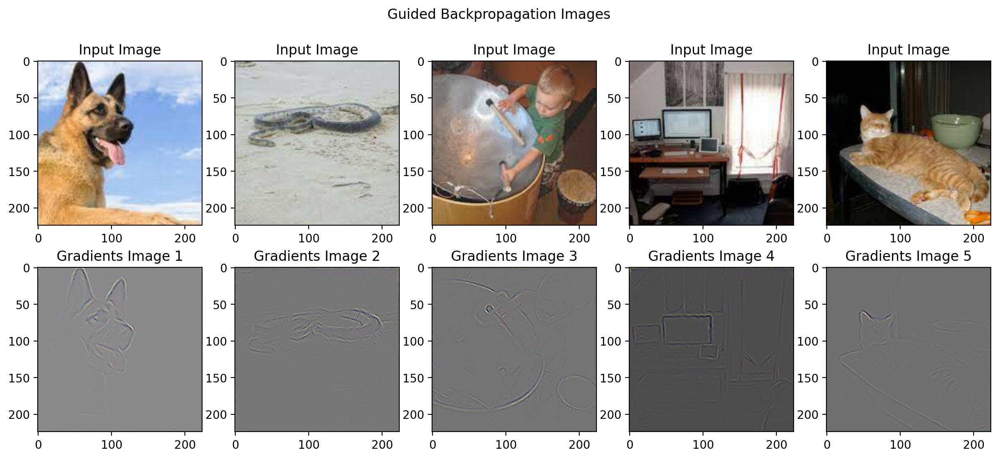

In [7]:
# Define the GuidedBackpropagation class
class GuidedBackprop:
    def __init__(self, model):
        self.model = model
        self.gradients = None
        self.handles = []
                
                
        #Function to perform a ReLU on the backpropagated gradients
        def backward_relu_hook(module, grad_in, grad_out):
            if isinstance(module, nn.ReLU):
                return (torch.clamp(grad_in[0], min=0.0),)

        #Function to register backward hooks for ReLU layers in a given model
        def register_relu_backward_hooks(model):
            # Iterate over child modules of the model
            for child in model.children():
                # Check if the child module is a ReLU layer
                if isinstance(child, nn.ReLU):

                    # Register a backward hook for the ReLU layer and store the hook handle
                    self.handles.append(child.register_backward_hook(backward_relu_hook))

                # If the child module is not a ReLU layer, recursively call this function on it
                else:
                    register_relu_backward_hooks(child)
        
        register_relu_backward_hooks(self.model)

    def __call__(self, input_image):
        input_image.requires_grad_()
        self.model.zero_grad()
        output = self.model(input_image)
        one_hot = output.max()
        one_hot.backward()
        gradients = input_image.grad.squeeze().numpy()
        return gradients
    
# Define image transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Plot the figures
fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(15, 6))

# Calculate the gradients for each image
for i, img in enumerate(images):
    # Preprocess the image
    input_image = preprocess(img).unsqueeze(0)

    # Get the predicted class and score
    with torch.no_grad():
        output = model(input_image)
    highest_neuron = np.argmax(output.numpy())
    score = output[0][highest_neuron].item()

    # Compute the gradients
    gradients = GuidedBackprop(model)(input_image)
    gradients = normalize(gradients)

    # Visualize the gradients and input image
    gradients = gradients.squeeze()
    axs[0, i].imshow(input_image.detach().numpy().squeeze(0).transpose(1, 2, 0))
    axs[0, i].set_title("Input Image")
    axs[1, i].imshow(gradients.transpose(1, 2, 0))
    axs[1, i].set_title(f"Gradients Image {i+1}")

plt.suptitle("Guided Backpropagation Images")
plt.show()

### Class Activation Map

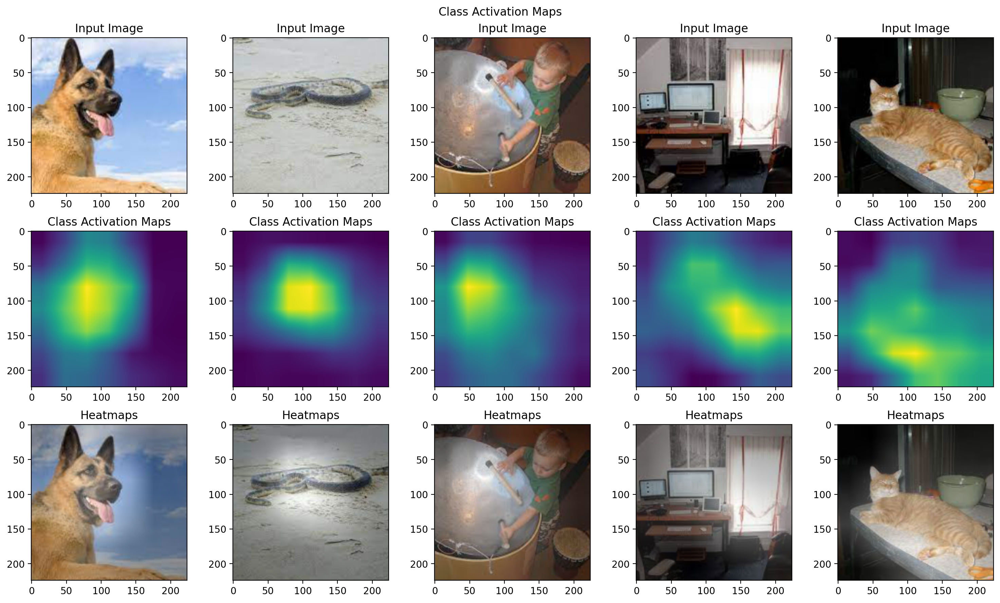

In [8]:
# Define the CAM class
class CAM():
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradient = None
        self.activations = None
        self.model.eval()

        def backward_hook(module, grad_input, grad_output):
            self.gradient = grad_output[0].cpu().data.numpy()

        def forward_hook(module, input, output):
            self.activations = output.cpu().data.numpy()

        self.handle = self.target_layer.register_forward_hook(forward_hook)
        self.handle_back = self.target_layer.register_backward_hook(backward_hook)
        
        
        model.layer4[-1].relu.register_forward_hook(forward_hook)
        model.layer4[-1].relu.register_backward_hook(backward_hook)

    def __call__(self, input_image, class_index=None):
        self.model.zero_grad()
        output = self.model(input_image)
        if class_index is None:
            class_index = torch.argmax(output.cpu().data.numpy())
        target = output[0][class_index]
        target.backward()

        # Get the activations and gradient
        activations = self.activations
        gradient = self.gradient
        weights = model.fc.weight[class_index,:].reshape(-1, 1, 1).detach()
        cam = torch.sum(weights * activations, axis=1).unsqueeze(0)
        cam = np.maximum(cam, 0)
        cam = F.interpolate(cam, size=(224, 224), mode='bilinear')

        return cam
    
# Define image transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])
    
fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(15, 9))

# Get the predicted class and the corresponding score for each image
for i, img in enumerate(images):
    # Preprocess the image
    input_image = preprocess(img).unsqueeze(0)

    # Get the predicted class and score
    with torch.no_grad():
        output = model(input_image)
    highest_neuron = np.argmax(output.numpy())
    score = output[0][highest_neuron].item()

    # Compute the CAM
    cam = CAM(model, model.layer4[-1].conv3)(input_image, highest_neuron)

    # Visualize the heatmap and input image
    cam = cam.squeeze(0)
    heatmap = np.uint8(255*normalize(normalize(input_image) * 0.6 + normalize(cam) * 0.4))
    
    axs[0, i].imshow(input_image.detach().numpy().squeeze(0).transpose(1, 2, 0))
    axs[0, i].set_title("Input Image")
    axs[1, i].imshow(cam[0])
    axs[1, i].set_title("Class Activation Maps")
    axs[2, i].imshow(heatmap.squeeze(0).transpose(1, 2, 0))
    axs[2, i].set_title("Heatmaps")

plt.suptitle("Class Activation Maps")
plt.tight_layout()
plt.show()

### Guided Grad-CAM

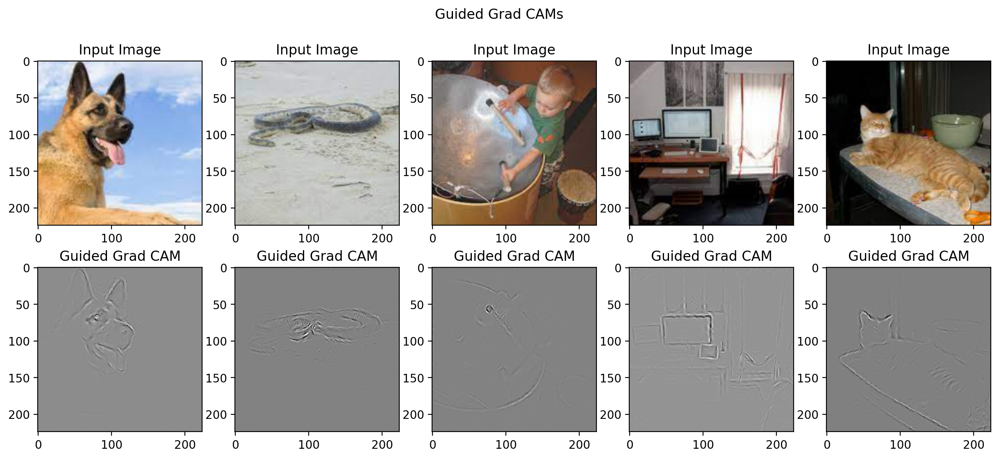

In [9]:
# Define the GuidedGradCAM class
class GuidedGradCAM:
    def __init__(self, model, target_layer):
        self.cam = CAM(model, target_layer)
        self.gb = GuidedBackprop(model)

    def __call__(self, input_image, class_index=None):
        cam = self.cam(input_image, class_index)
        gb = self.gb(input_image)
        guided_grads = np.multiply(cam, gb)
        
        return normalize(guided_grads)

# Define image transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(15, 6))

# Get the predicted class and the corresponding score for each image
for i, img in enumerate(images):
    # Preprocess the image
    input_image = preprocess(img).unsqueeze(0)
    
    # Get the predicted class and score
    with torch.no_grad():
        output = model(input_image)
    highest_neuron = np.argmax(output.numpy())
    score = output[0][highest_neuron].item()
    
    # Compute the guided grad CAM
    guided_grad_cam = GuidedGradCAM(model, model.layer4[-1].conv3)(input_image, highest_neuron)
       
    # Visualize the Guided Grad CAM and input image
    guided_grad_cam = guided_grad_cam.squeeze()
    axs[0, i].imshow(input_image.detach().numpy().squeeze(0).transpose(1, 2, 0))
    axs[0, i].set_title("Input Image")
    axs[1, i].imshow(guided_grad_cam[0], cmap='gray', interpolation='nearest')
    axs[1, i].set_title("Guided Grad CAM")

plt.suptitle("Guided Grad CAMs")
plt.show()

# Question 2

**SGD Update rule variations**

Implement the following update rules to find the minimum for $f(x, y) = 10x^2 + y^2$
. You may
consider a random starting point and visualize the convergence (within the region covered by
points (-2, -2) and (2, 2) using a GIF) path taken by different update rules for a fixed (say, 50)
iterations. You are advised to tryout multiple meaning values for the hyper-parameters involved.

(a) Vanilla SGD

(b) SGD with momentum 

(c) Nesterov Momentum

(d) AdaGrad

(e) RMSProp

In [52]:
# Define the function
def f(x, y):
    return 10*x**2 + y**2

# Define the gradient of the function
def grad_f(x, y):
    return np.array([20*x, 2*y])

# Set the parameters
np.random.seed(47)
w = np.random.uniform(low=(-2,-2), high=(2,2))
iters = 50

### Vanilla SGD

In [59]:
# Set the hyperparameters
w_van = w
lr_van = 0.09

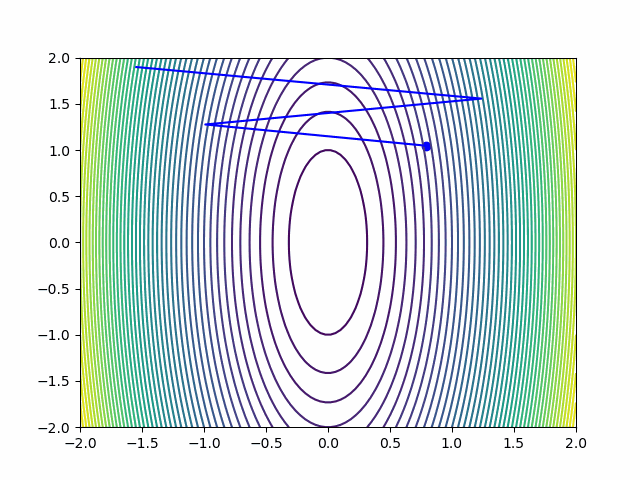

In [60]:
# Create a figure and axis
fig, ax = plt.subplots()

# Define the x and y ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# Plot the function
Z = f(X, Y)
ax.contour(X, Y, Z, levels=50)

# Initialize the scatter plot
scatter = ax.scatter(w_van[0], w_van[1], color='blue')
path, = ax.plot(w_van[0], w_van[1], color='blue')
plt.close()

# Define the update function
def Vanilla_SGD(frame):
    global w_van
    # Calculate the gradient
    grad = grad_f(w_van[0], w_van[1])
    
    # Update the current point
    w_van = w_van - lr_van * grad
    
    # Update the scatter plot
    scatter.set_offsets(w_van)
    path.set_xdata(np.append(path.get_xdata(), w_van[0]))
    path.set_ydata(np.append(path.get_ydata(), w_van[1]))
    
    # Return the scatter plot as a sequence of artist objects
    return scatter, path, 

# Create the animation
anim = FuncAnimation(fig, Vanilla_SGD, frames=iters, interval=200, blit=True)

# Save the animation as a GIF
anim.save('vanilla_sgd_convergence.gif', writer=animation.PillowWriter(fps=8))

# fig.suptitle('Vanilla SGD', fontsize=14);
Image('vanilla_sgd_convergence.gif')

### SGD with Momentum

In [72]:
# Set the hyperparameters
w_mom = w
v_mom = np.zeros_like(w_mom)
lr_mom = 0.06
gamma_mom = 0.9

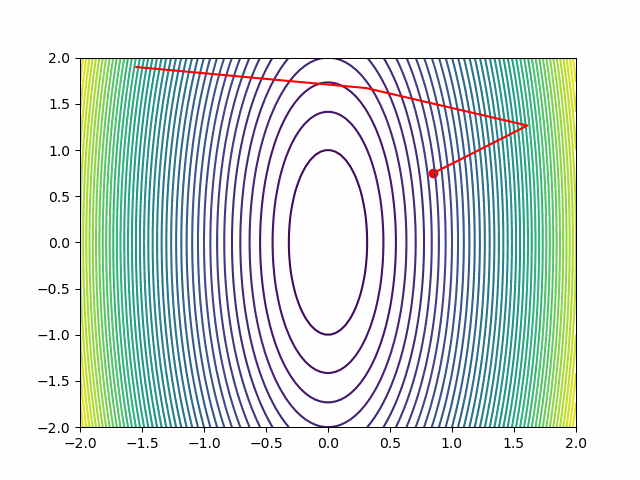

In [73]:
# Create a figure and axis
fig, ax = plt.subplots()

# Define the x and y ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# Plot the function
Z = f(X, Y)
ax.contour(X, Y, Z, levels=50)

# Initialize the scatter plot
scatter = ax.scatter(w_mom[0], w_mom[1], color='red')
path, = ax.plot(w_mom[0], w_mom[1], color='red')
plt.close()

# Define the update function
def Momentum_SGD(frame):
    global w_mom, v_mom
    # Calculate the gradient
    grad = grad_f(w_mom[0], w_mom[1])
    
    # Update the velocity
    v_mom = gamma_mom * v_mom + lr_mom * grad
    
    # Update the current point
    w_mom = w_mom - v_mom
    
    # Update the scatter plot
    scatter.set_offsets(w_mom)
    path.set_xdata(np.append(path.get_xdata(), w_mom[0]))
    path.set_ydata(np.append(path.get_ydata(), w_mom[1]))
    
    # Return the scatter plot as a sequence of artist objects
    return scatter, path, 

# Create the animation
anim = FuncAnimation(fig, Momentum_SGD, frames=iters*2, interval=200, blit=True)

# Save the animation as a GIF
anim.save('sgd_momentum_convergence.gif', writer=animation.PillowWriter(fps=10))

# fig.suptitle('Momentum SGD', fontsize=14);
Image('sgd_momentum_convergence.gif')

### Nesterov Momentum

In [84]:
# Set the hyperparameters
w_nest = w
v_nest = np.zeros_like(w_nest)
lr_nest = 0.1
gamma_nest = 0.9

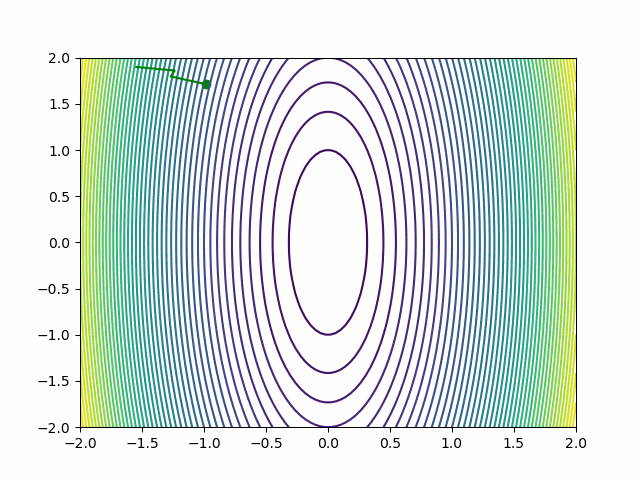

In [85]:
# Create a figure and axis
fig, ax = plt.subplots()

# Define the x and y ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# Plot the function
Z = f(X, Y)
ax.contour(X, Y, Z, levels=50)

# Initialize the scatter plot
scatter = ax.scatter(w_nest[0], w_nest[1], color='green')
path, = ax.plot(w_nest[0], w_nest[1], color='green')
plt.close()

# Define the update function
def Nesterov(frame):
    global w_nest, v_nest
    # Calculate the lookahead point
    lookahead_w = w_nest - gamma_nest * v_nest
    
    # Calculate the gradient at the lookahead point
    lookahead_grad = grad_f(lookahead_w[0], lookahead_w[1])
    
    # Update the velocity
    v_nest = gamma_nest * v_nest + lr_nest * lookahead_grad
    
    # Update the current point
    w_nest = w_nest - lr_nest * v_nest
    
    # Update the scatter plot
    scatter.set_offsets(w_nest)
    path.set_xdata(np.append(path.get_xdata(), w_nest[0]))
    path.set_ydata(np.append(path.get_ydata(), w_nest[1]))
    
    # Return the scatter plot as a sequence of artist objects
    return scatter, path,

# Create the animation
anim = FuncAnimation(fig, Nesterov, frames=iters, interval=200, blit=True)

# Save the animation as a GIF
anim.save('nesterov_convergence.gif', writer=animation.PillowWriter(fps=10))

# fig.suptitle('Nesterov Momentum', fontsize=14);
Image('nesterov_convergence.gif')

### AdaGrad

In [90]:
# Set the hyperparameters
w_ada = w
grad_sq = np.zeros_like(w_ada)
lr_ada = 0.2
eps = 1e-8

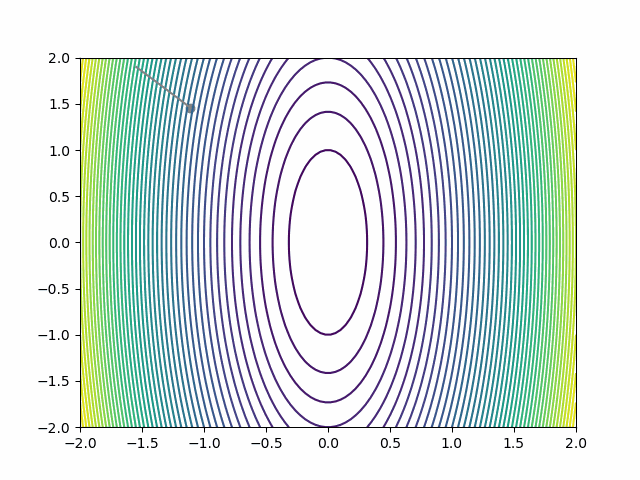

In [91]:
# Create a figure and axis
fig, ax = plt.subplots()

# Define the x and y ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# Plot the function
Z = f(X, Y)
ax.contour(X, Y, Z, levels=50)

# Initialize the scatter plot
scatter = ax.scatter(w_ada[0], w_ada[1], color='gray')
path, = ax.plot(w_ada[0], w_ada[1], color='gray')
plt.close()

# Define the update function
def AdaGrad(frame):
    global w_ada, grad_sq
    # Calculate the gradient at the current point
    grad = grad_f(w_ada[0], w_ada[1])
    
    # Update the sum of squared gradients
    grad_sq += grad**2
    
    # Calculate the adaptive learning rate
    lr_t = lr_ada / (np.sqrt(grad_sq) + eps)
    
    # Update the current point
    w_ada = w_ada - lr_t * grad
    
    # Update the scatter plot
    scatter.set_offsets(w_ada)
    path.set_xdata(np.append(path.get_xdata(), w_ada[0]))
    path.set_ydata(np.append(path.get_ydata(), w_ada[1]))
    
    # Return the scatter plot as a sequence of artist objects
    return scatter, path,

# Create the animation
anim = FuncAnimation(fig, AdaGrad, frames=iters, interval=200, blit=True)

# Save the animation as a GIF
anim.save('adagrad_convergence.gif', writer=animation.PillowWriter(fps=10))

# fig.suptitle('AdaGrad', fontsize=14);
Image('adagrad_convergence.gif')

### RMSProp

In [92]:
# Set the initial values
w_rms = w
grad_avg_sq = np.zeros_like(w_rms)
lr_rms = 0.05
gamma_rms = 0.9
eps_rms = 1e-8

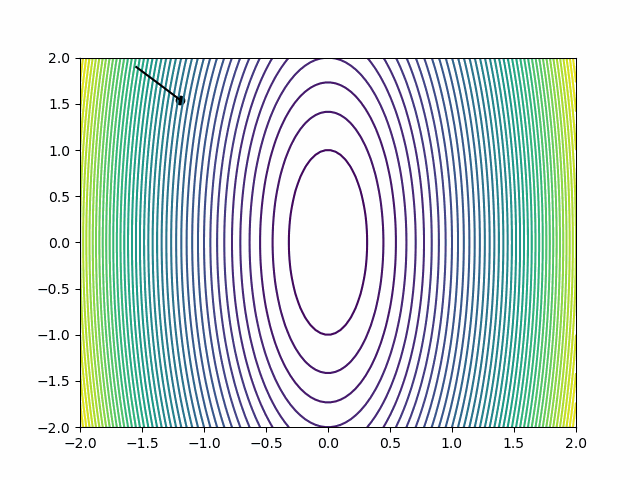

In [93]:
# Create a figure and axis
fig, ax = plt.subplots()

# Define the x and y ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# Plot the function
Z = f(X, Y)
ax.contour(X, Y, Z, levels=50)

# Initialize the scatter plot
scatter = ax.scatter(w_rms[0], w_rms[1], color='black')
path, = ax.plot(w_rms[0], w_rms[1], color='black')
plt.close()

# Define the update function
def RMSProp(frame):
    global w_rms, grad_avg_sq
    # Calculate the gradient at the current point
    grad = grad_f(w_rms[0], w_rms[1])
    
    # Update the exponentially-weighted average of the squared gradients
    grad_avg_sq = gamma_rms * grad_avg_sq + (1 - gamma_rms) * grad**2
    
    # Calculate the adaptive learning rate
    lr_t = lr_rms / (np.sqrt(grad_avg_sq) + eps_rms)
    
    # Update the current point
    w_rms = w_rms - lr_t * grad
    
    # Update the scatter plot
    scatter.set_offsets(w_rms)
    path.set_xdata(np.append(path.get_xdata(), w_rms[0]))
    path.set_ydata(np.append(path.get_ydata(), w_rms[1]))
    
    # Return the scatter plot as a sequence of artist objects
    return scatter, path,

# Create the animation
anim = FuncAnimation(fig, RMSProp, frames=iters, interval=200, blit=True)

# Save the animation as a GIF
anim.save('rmsprop_convergence.gif', writer=animation.PillowWriter(fps=10))

# fig.suptitle('RMSProp', fontsize=14);
Image('rmsprop_convergence.gif')